## Analysis notebook for Thompson Sampling of GDH-CatIB strains

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import arviz
from matplotlib import pyplot
import numpy
import pandas
import pathlib
import pymc
import scipy

import calibr8
import catibts
import pyrff

Could not locate executable g77
Could not locate executable f77
Could not locate executable ifort
Could not locate executable ifl
Could not locate executable f90
Could not locate executable DF
Could not locate executable efl


WARNING (aesara.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [3]:
%load_ext watermark
%watermark --iversions

catibts   : 0.3.0
scipy     : 1.7.3
matplotlib: 3.5.1
pymc      : 4.0.0b2
pyrff     : 2.0.1
pandas    : 1.4.1
numpy     : 1.21.5
arviz     : 0.11.4
calibr8   : 6.5.1



In [4]:
fp_experiment = pathlib.Path(r"../data")
fp_experiment.exists()
runinfo_df = pandas.read_excel(f"{fp_experiment}/run_overview.xlsx", index_col=0)
runinfo_df

,run_id-VK,result_file-VK,run_id-HK,result_file-HK,run_id-Assay,result_file(s)-Assay,Anmerkungen
sround,,,,,,,
0,D15DTK,ReHa_CatIB_VK_2022-01-27_16-30-13.csv,D19YYZ,ReHa_CatIB_HK_2022-01-28_12-32-33.csv,D1X8DM,"2022-01-31_07-12_Fluorescence.xml, 2022-01-31_...",Hier hatte ich in der VK noch mit dem shutil-B...
1,D95YC6,ReHa_CatIB_VK_2022-03-03_19-34-37.csv,D9A1YM,ReHa_CatIB_HK_2022-03-04_14-10-23.csv,D9XCLX,"2022-03-07_09-34_Fluorescence.xml, 2022-03-08_...","Für die Vokultur gibt es mehrere Runs, die jew..."
2,DAFT9R,ReHa_CatIB_VK_2022-03-10_16-00-57.csv,DAMZ19,ReHa_CatIB_HK_2022-03-11_10-23-45.csv,DB984D,2022-03-14_05-41_Fluorescence.xml,Einige Wells der Vorkultur sind nicht richtig ...
3,DDA79K,ReHa_CatIB_VK_2022-03-24_15-26-08.csv,DDEBDB,ReHa_CatIB_HK_2022-03-25_09-54-09.csv,DE3MB4,2022-03-28_05-09_Fluorescence.xml,Ein Well zeigte schon in der VK Verhaltensauff...


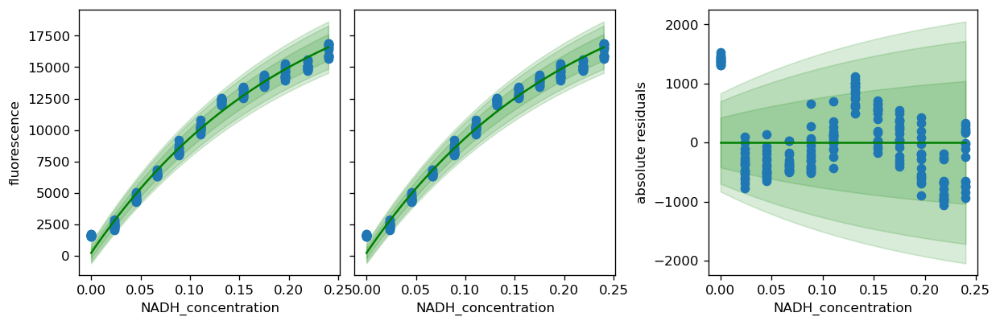

In [5]:
RUN_ID = "DE3MB4" #"DE3MB4", #"D9XCLX" "D1X8DM" "DB984D"
resultpath = f'Results\{RUN_ID}' 
cm_nadh = catibts.NADHFluorescenceModel.load(rf"{resultpath}\{RUN_ID}_cm_nadh.json")
fig, axs = calibr8.plot_model(cm_nadh)
pyplot.show()

In [6]:
df_kinetics = catibts.concatenate_kinetics(
    run_list=list(runinfo_df["run_id-Assay"]),
    runinfo_df=runinfo_df,
    fp_experiment=fp_experiment,
    cut_cycle=146
)
df_kinetics

time  \
strain  kinetic_id run    column_id concentration_factor cycle               
RoSa10  B02_D1X8DM D1X8DM 2         1                    1        0.286968   
                                                         2        1.526002   
                                                         3        2.765152   
                                                         4        4.004035   
                                                         5        5.243168   
...                                                                    ...   
RoSa130 G09_DE3MB4 DE3MB4 9         1                    142    175.745368   
                                                         143    176.984518   
                                                         144    178.223318   
                                                         145    179.462235   
                                                         146    180.701135   

                                                                value  
strain  kinetic_id run    column_id concentration_factor cycle         
RoSa10  B02_D1X8DM D1X8DM 2         1                    1        229  
                                                         2        227  
                                                         3        229  
                                                         4        227  
                                                         5        228  
...                                                               ...  
RoSa130 G09_DE3MB4 DE3MB4 9         1                    142     3101  
                                                         143     3115  
                                                         144     3129  
                                                         145     3145  
                                                         146     3170  

[26864 rows x 2 columns]

## Creating the Model

In [7]:
model = catibts.CatIBModel(
    df_kinetics=df_kinetics,
    cm_nadh=cm_nadh,
)
# the shapes of the dataset are encoded in the "coords" of the underlying PyMC model:
model.summary()

c:\Users\helleckes\AppData\Local\Continuum\miniconda3\envs\catib-ts38\lib\site-packages\pymc\data.py:640: FutureWarning: The `mutable` kwarg was not specified. Currently it defaults to `pm.Data(mutable=True)`, which is equivalent to using `pm.MutableData()`. In v4.1.0 the default will change to `pm.Data(mutable=False)`, equivalent to `pm.ConstantData`. Set `pm.Data(..., mutable=False/True)`, or use `pm.ConstantData`/`pm.MutableData`.
  warnings.warn(


strain              (64,)	KK166, KK167, KK169, …, RoSa99
kinetic_id          (184,)	B02_D1X8DM, B02_D9XCLX, B02_DB984D, …, G09_DE3MB4
column_id           (8,)	2, 3, 4, …, 9
run                 (4,)	D1X8DM, D9XCLX, DB984D, DE3MB4
assay_cycle         (146,)	0, 1, 2, …, 145


The PyMC3 model can be visualized as a graph:

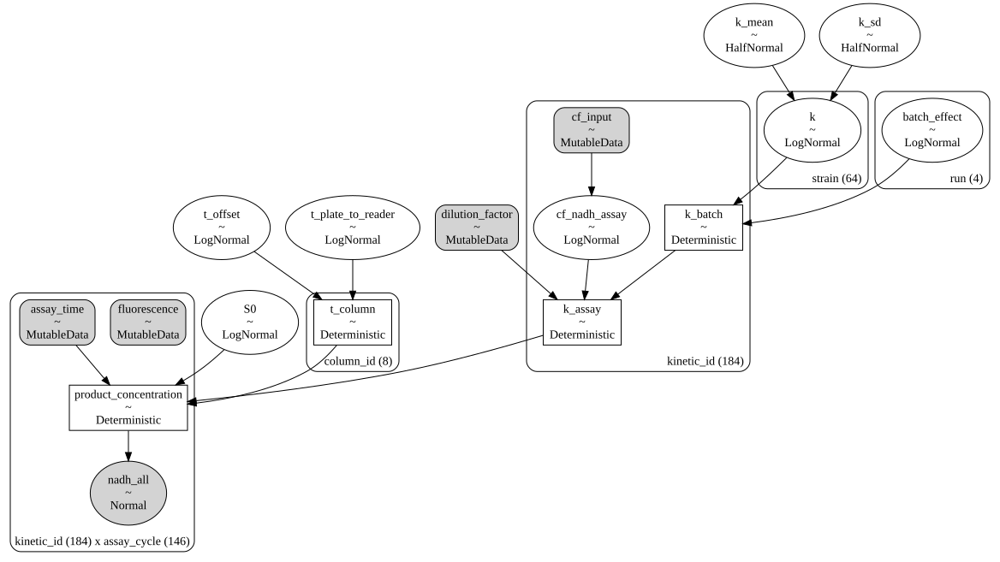

In [8]:
pymc.model_to_graphviz(model.pmodel)

In [12]:
with model.pmodel:
    idata = pymc.sample_prior_predictive(return_inferencedata=True)
idata

Inference data with groups:
	> prior
	> prior_predictive
	> observed_data

The result should be saved such that the analysis can run in another notebook.

In [13]:
idata.to_netcdf(fr"{resultpath}\{RUN_ID}_catib-ts_round4.nc")

'Results\\DE3MB4\\DE3MB4_prior_predictive.nc'

Execute the next cell in case you want to reload saved data

In [14]:
idata = arviz.from_netcdf(fr"{resultpath}\{RUN_ID}_catib-ts_round4.nc")

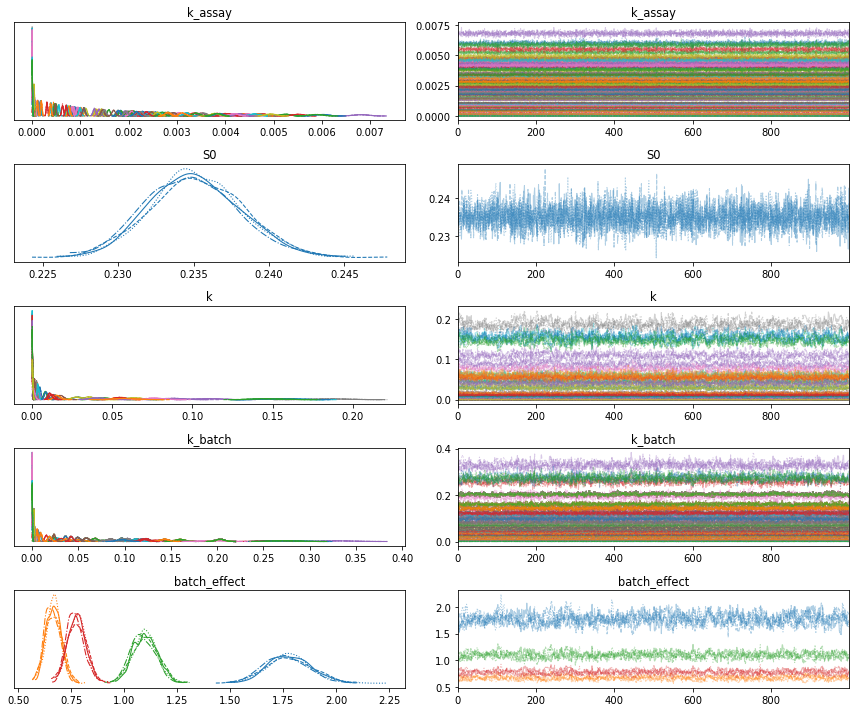

In [15]:
arviz.plot_trace(idata, var_names=[
    "k_assay", "S0", "k", "k_batch", "batch_effect",
])
pyplot.tight_layout()

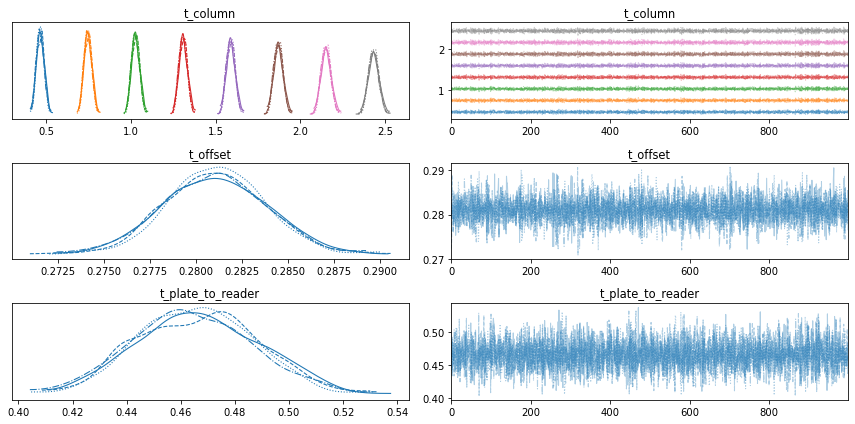

In [74]:
arviz.plot_trace(idata, var_names=[
    "t_column", "t_offset", "t_plate_to_reader"
])
pyplot.tight_layout()
# The left subplots show the posterior probability density.
# The right subplots show the MCMC. If they look like random noise everything is fine.
# The linestyle corresponds to independent MCMC chains - they should come to the same result.

c:\Users\helleckes\AppData\Local\Continuum\miniconda3\envs\catib-ts38\lib\site-packages\arviz\plots\backends\matplotlib\pairplot.py:238: UserWarning: rcParams['plot.max_subplots'] (144) is smaller than the number of resulting pair plots with these variables, generating only a 16x16 grid
  warnings.warn(


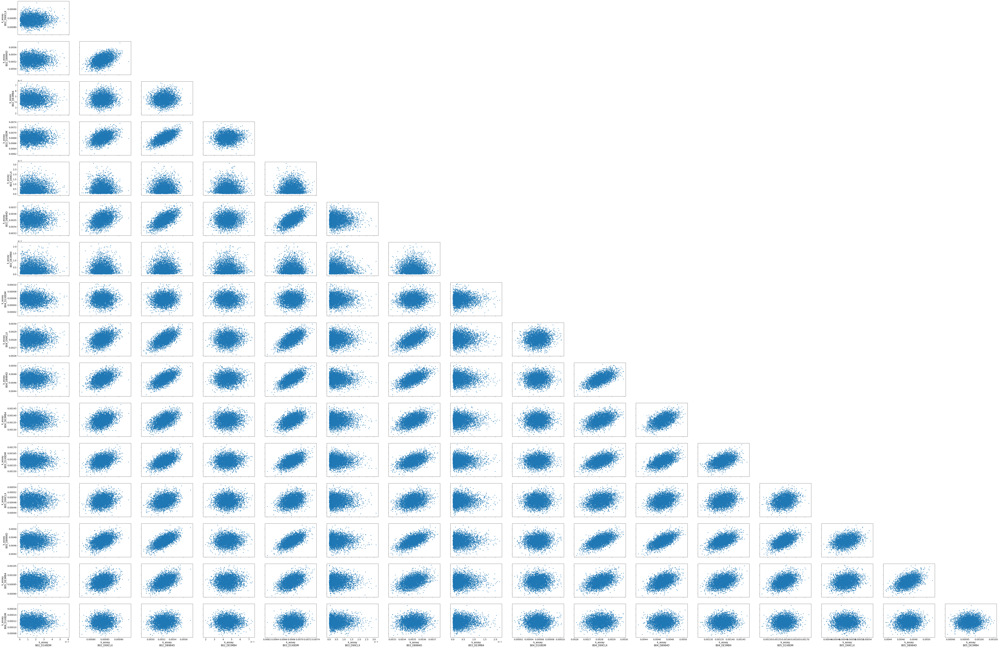

In [16]:
arviz.rcParams['plot.max_subplots'] = 144
arviz.plot_pair(idata, var_names=[
    "k_assay", 
    "k", "k_batch", "S0"
]);

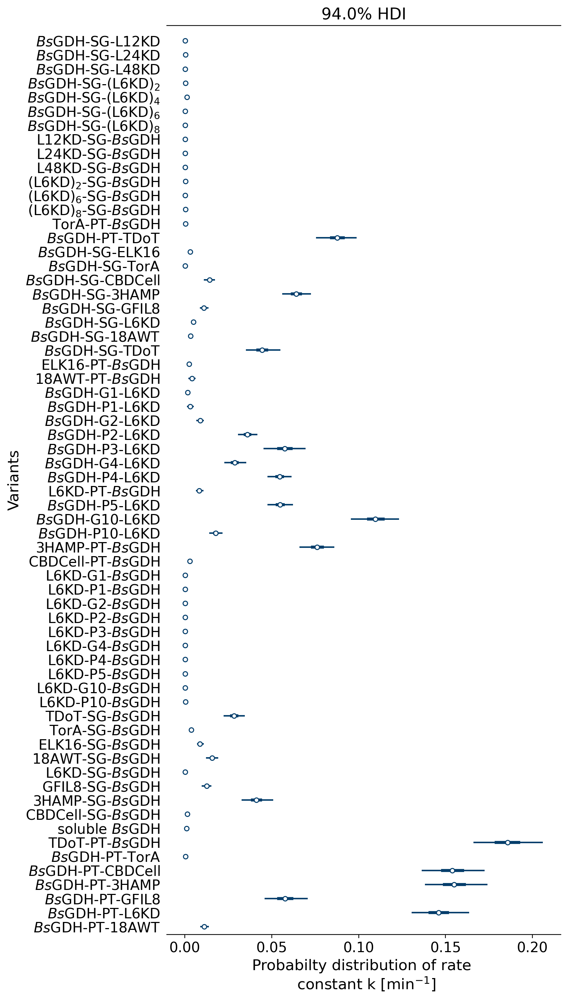

In [17]:
strain_dict = catibts.VARIANT_MAPPER

fig, ax = pyplot.subplots(figsize=(8,14), dpi=200)
arviz.plot_forest(idata, var_names=["k"], combined=True, ax=ax, colors=["#023D6B"])
ax.set_xlabel("Probabilty distribution of rate \n constant k [min$^{-1}$]", size=15)
strains = [strain_dict[strain] for strain in model.strains]
ax.set_yticklabels(strains[::-1])
#ax.set_xlim(-0.2, 1.2)
ax.set_ylabel("Variants", size=15)
pyplot.tight_layout()
# pyplot.savefig(fr"{resultpath}\{RUN_ID}_CatIB_kprobs_round4.png", dpi=200)

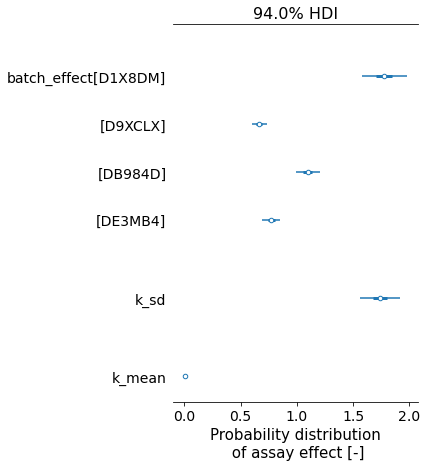

In [18]:
arviz.plot_forest(idata, var_names=["batch_effect", "k_sd", "k_mean"], combined=True)
pyplot.xlabel("Probability distribution\n of assay effect [-]", size=15)
pyplot.tight_layout()
#pyplot.savefig(fr"{resultpath}\{RUN_ID}_assay-effect(round4).png", dpi=200)

In [19]:
posterior = idata.posterior.stack(sample=("chain", "draw"))
posterior

<xarray.Dataset>
Dimensions:                (kinetic_id: 184, sample: 4000, strain: 64, run: 4,
                            column_id: 8, assay_cycle: 146)
Coordinates:
  * kinetic_id             (kinetic_id) object 'B02_D1X8DM' ... 'G09_DE3MB4'
  * strain                 (strain) object 'KK166' 'KK167' ... 'RoSa98' 'RoSa99'
  * run                    (run) object 'D1X8DM' 'D9XCLX' 'DB984D' 'DE3MB4'
  * column_id              (column_id) int32 2 3 4 5 6 7 8 9
  * assay_cycle            (assay_cycle) int32 0 1 2 3 4 ... 141 142 143 144 145
  * sample                 (sample) MultiIndex
  - chain                  (sample) int64 0 0 0 0 0 0 0 0 0 ... 3 3 3 3 3 3 3 3
  - draw                   (sample) int64 0 1 2 3 4 5 ... 995 996 997 998 999
Data variables:
    cf_nadh_assay          (kinetic_id, sample) float64 0.901 1.022 ... 0.8482
    k_sd                   (sample) float64 1.682 1.776 1.836 ... 1.968 1.596
    k_mean                 (sample) float64 0.003031 0.003057 ... 0.003279
    k                      (strain, sample) float64 0.0001693 ... 0.01057
    batch_effect           (run, sample) float64 1.685 1.579 ... 0.7376 0.7324
    t_offset               (sample) float64 0.2808 0.2794 ... 0.2824 0.2779
    t_plate_to_reader      (sample) float64 0.5009 0.4518 ... 0.4605 0.4883
    S0                     (sample) float64 0.2329 0.2359 ... 0.2314 0.2387
    k_batch                (kinetic_id, sample) float64 0.0004028 ... 0.04125
    k_assay                (kinetic_id, sample) float64 7.258e-06 ... 0.0006998
    t_column               (column_id, sample) float64 0.5009 0.4518 ... 2.434
    product_concentration  (kinetic_id, assay_cycle, sample) float64 1.332e-0...
Attributes:
    created_at:                 2022-03-29T11:41:18.292623
    arviz_version:              0.11.4
    inference_library:          pymc
    inference_library_version:  4.0.0b2
    sampling_time:              1775.077079296112
    tuning_steps:               1000

In [20]:
strains = numpy.unique(model.strains)
numpy.random.seed(220310)
selected_strains = pyrff.sample_batch(
    posterior.k.values,
    ids=strains,
    batch_size=48,
    correlated=True
)
numpy.unique(selected_strains, return_counts=True)

(array(['RoSa9'], dtype='<U5'), array([48], dtype=int64))

In [21]:
selected_strains_shuffled = numpy.copy(selected_strains)
numpy.random.shuffle(selected_strains_shuffled)
wells = [f"{l}{n:02d}" for l in "ABCDEF" for n in range(1,9)]
mtp_wells = [f"{l}{n:02d}" for l in "BCDEFG" for n in range(2,10)]
inoculation_dict = {
    i: (well, strain, mtp_well)
    for i, (well, mtp_well, strain) in enumerate(zip(wells, mtp_wells, selected_strains_shuffled))
}

df=pandas.DataFrame.from_dict(inoculation_dict, columns=["fp_well", "strain", "mtp_well"], orient="index")
#df.to_excel(f"{resultpath}\screening4.xlsx", sheet_name="samples", index=False)

In [22]:
set(list(selected_strains)) - set(df_kinetics.index.get_level_values("strain"))

set()

In [23]:
probs = pyrff.sampling_probabilities(
    posterior.k.values,
    correlated=True
)

In [24]:
for strain, count in zip(
    numpy.unique(selected_strains, return_counts=True)[0],
    numpy.unique(selected_strains, return_counts=True)[1]
):
    print(strain_dict[strain])
    print(count)

TDoT-PT-$Bs$GDH
48


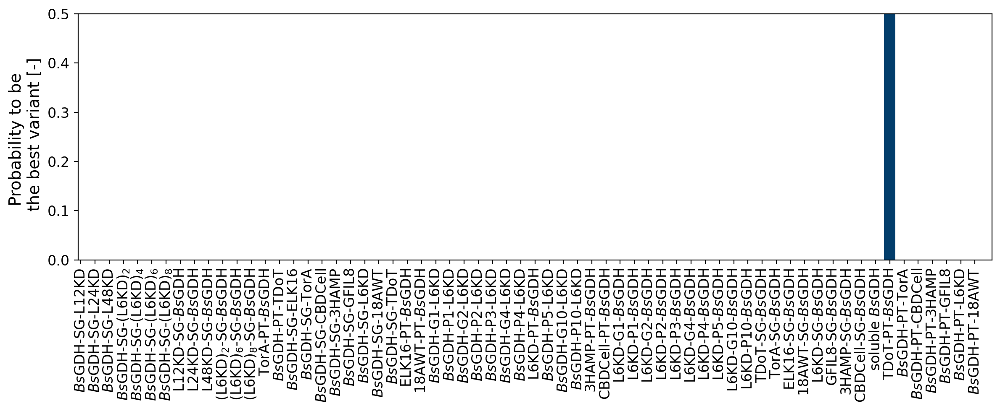

In [25]:
fig, ax = pyplot.subplots(figsize=(12,5), dpi=200)
ax.bar(x=numpy.arange(len(probs)), height=probs, color="#023D6B")
ax.set_xlim(-0.2, 64.2)
ax.set_ylim(0, 0.5)
ax.set_xticks(numpy.arange(len(probs)), labels=[strain_dict[strain] for strain in strains], rotation=90)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_ylabel("Probability to be \n the best variant [-]", size=14)
pyplot.tight_layout()
# pyplot.savefig(fr"{resultpath}\{RUN_ID}_TS_probs(round0).png", dpi=200)

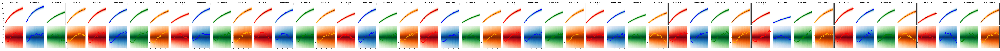

In [26]:
#for strain in posterior.strains.values:
strain="RoSa9"
try:
    kinetic_ids = numpy.unique(df_kinetics.loc[strain,:,:,:].index.get_level_values("kinetic_id"))
except KeyError:
    kinetic_ids=None
    
if kinetic_ids is not None:
    fig, axs = pyplot.subplots(
            dpi=140,
            figsize=( 4*len(kinetic_ids), 10),
            ncols=len(kinetic_ids),
            nrows=2,
            sharey="row",
            sharex="col",
            squeeze=False,
        )
    color_options = [
        ("red", "Reds"),
        ("blue", "Blues"),
        ("green", "Greens"),
        ("orange", "Oranges"),
    ]
    for k, kid in enumerate(kinetic_ids):
        color, cmap = color_options[k-k//4*4]
        df = df_kinetics.loc[strain, kid,:,:]
        residual_ptp = 0
        cid = int(kid.split("_")[0][-1])

        # and the actual absorbance
        fluorescence = idata.constant_data.fluorescence.sel(kinetic_id=kid)
        #print(color, kid, cid)

        axs[0,k].scatter(
            idata.constant_data.assay_time.values[0,:],#+ numpy.mean(posterior.t_column.sel(column_id=cid).values),
            fluorescence,
            marker="x",
            color=color,
            zorder=10
        )

        loc, sigma = cm_nadh.predict_dependent(
            posterior.product_concentration.sel(kinetic_id=kid).values,

        )
        pp_samples = scipy.stats.norm.rvs(loc=loc, scale=sigma)
        pymc.gp.util.plot_gp_dist(
            ax=axs[0,k],
            samples=pp_samples.T,
            x=idata.constant_data.assay_time.values[0,:],
            palette=cmap,
            plot_samples=False,
        )

        #residuals
        median = numpy.median(pp_samples, axis=1)
        residuals = fluorescence.values - median
        residual_ptp = max(residual_ptp, numpy.ptp(residuals))

        pymc.gp.util.plot_gp_dist(
            ax=axs[1, k],
            samples=(pp_samples - median[:,None]).T,
            x=idata.constant_data.assay_time.values[0,:],
            plot_samples=False,
            palette=cmap
        )
        axs[1, k].scatter(
            idata.constant_data.assay_time.values[0,:], residuals, marker="x", color=color, zorder=10
        )
        axs[0, k].plot([], [], color=color, label=kid)
    # formatting
        axs[0, k].set_title(f"kinetic id '{kid}'")
        axs[1, k].set_xlabel("time [min]") 
        axs[0, k].legend()

    axs[0, 0].set_ylabel(
        "Fluorescence [a.u.]"
    )
    axs[1, 0].set_ylim(-residual_ptp, residual_ptp)
    axs[1, 0].set_ylabel("residual ")
    fig.suptitle(
        f"Model fit to '{strain}' replicates"
    )
    fig.tight_layout()
else: #Some strains were not measured yet
    fig, axs = pyplot.subplots(
        ncols=2,
        sharex=True,
        dpi=140,
        figsize=(6, 4),
        squeeze=False,
    )
    color, cmap = ("red", "Reds")
    product_concentration = numpy.array(posterior.S0)[:,None] * \
    (1 - numpy.exp(-numpy.array(posterior.k.sel(strain=strain))[:,None] / \
    idata.constant_data.dilution_factor.values * (idata.constant_data.assay_time.values[0,:])))
    pymc.gp.util.plot_gp_dist(
        ax=axs[0,0],
        samples=product_concentration,
        x=idata.constant_data.assay_time.values[0,:],
        palette=cmap,
        plot_samples=False,
    )
    fluorescence, _ = cm_nadh.predict_dependent(product_concentration)
    pymc.gp.util.plot_gp_dist(
        ax=axs[0,1],
        samples=fluorescence,
        x=idata.constant_data.assay_time.values[0,:],
        palette=cmap,
        plot_samples=False,
    )
    axs[0, 0].set_title(f"prior for {strain}")
    axs[0, 0].set_xlabel("time [min]") 
    axs[0, 0].set_ylabel("predicted concentration [mM]") 
    axs[0, 1].set_ylabel("predicted fluorescence [a.u.]") 
pyplot.tight_layout()